In [1]:
import pandas as pd
import re
import numpy as np

from sklearn.linear_model import LinearRegression,QuantileRegressor
from sklearn.preprocessing import OneHotEncoder,StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error

from sklearn.linear_model import LassoCV
from sklearn.linear_model import RidgeCV

from sklearn.feature_selection import SelectKBest,f_regression,f_classif
from scipy.stats import pearsonr
import seaborn as sns

from sklearn.preprocessing import PolynomialFeatures


import seaborn as sns
import matplotlib.pyplot as plt

# 一、预处理函数
 1、提取有用的信息

In [2]:
# 提取户型的信息

def extract_and_sum(text):
    if pd.isnull(text)==False:
        numbers=list(map(float, re.findall(r'\d+\.?\d*', text)))
        return sum(numbers)

extract_and_sum(None)

extract_and_sum("3室1厅2厕")

6.0

In [3]:
# 将高楼层、中楼层、顶楼的分为一类，这些可能具有更高的价格

def lou_ceng(text):
    if pd.isnull(text)==False:
        if '高' or '中' or '顶' in text:
            return 1
        else:
            return 0
            

In [4]:
# 提取数字

def extract(text):
    if pd.isnull(text)==False:
        match=re.search(r'\d+\.?\d*',text)
        if match:
            return float(match.group())
    
extract('123.5yuan')

123.5

In [5]:
# 提取梯户比例

def chinese_to_arabic(text):
    # 中文数字到阿拉伯数字的映射
    chinese_to_arabic = {
        '零': 0, '一': 1, '二': 2, '三': 3, '四': 4,
        '五': 5, '六': 6, '七': 7, '八': 8, '九': 9,
        '十': 10, '百': 100, '千': 1000, '万': 10000,
        '两':2
    }
    
    total = 0
    temp = 0
    for char in text:
        if char in chinese_to_arabic:
            value = chinese_to_arabic[char]
            if value >= 10:  # 单位字符（如 "十", "百"）
                if temp == 0:  # 如果没有前导数字，默认为 1（如 "十二" 等价于 "一十二"）
                    temp = 1
                temp *= value
                total += temp
                temp = 0
            else:  # 数字字符（如 "一", "二"）
                temp = value
    total += temp  # 处理最后的数字
    return total

def ti_hu(text):
    if pd.isnull(text)==False:
        parts=text.split("梯")
        ti=chinese_to_arabic(parts[0])
        hu=chinese_to_arabic(parts[1].rstrip("户"))
        return ti/hu

ti_hu("一梯四户")

0.25

In [6]:
# 提取物业费

def wu_ye(text):
    if pd.isnull(text)==False:
        numbers = list(map(float, re.findall(r'-?\d+\.?\d*', text)))
        if len(numbers) == 1:
            return numbers[0]  # 只有一个数字，直接返回
        elif len(numbers) == 2:
            return (numbers[0]-numbers[1]) / 2  # 两个数字，返回均值

wu_ye("1.2-2.3")

1.75

In [7]:
def to_number(data):
    newdata=pd.DataFrame()
    newdata=data.replace(fuzhi)
    newdata[['城市','区域','板块']]=data[['城市','区域','板块']].astype(int)

    newdata['房屋户型']=data['房屋户型'].apply(extract_and_sum)
    newdata['所在楼层']=data['所在楼层'].apply(lou_ceng)
    newdata['建筑面积']=data['建筑面积'].apply(extract)
    newdata['套内面积']=data['套内面积'].apply(extract)
    newdata['梯户比例']=data['梯户比例'].apply(ti_hu)
    newdata['房屋总数']=data['房屋总数'].apply(extract)
    newdata['楼栋总数']=data['楼栋总数'].apply(extract)
    newdata['绿 化 率']=data['绿 化 率'].apply(extract)
    newdata['物 业 费']=data['物 业 费'].apply(wu_ye)

    newdata['燃气费']=data['燃气费'].apply(wu_ye)
    newdata['供热费']=data['供热费'].apply(wu_ye)

    return(newdata)

# '城市', '区域', '板块', '环线', '小区名称', '价格', '房屋户型', '所在楼层', '建筑面积', '套内面积',
#       '建筑结构', '装修情况', '梯户比例', '配备电梯', '别墅类型', '交易权属', '房屋用途', '房屋年限', '产权所属',
#       'lon', 'lat', '房屋总数', '楼栋总数', '绿 化 率', '容 积 率', '物 业 费', '供水', '供暖',
#       '供电', '燃气费', '供热费', '停车位', 'coord_x', 'coord_y'],


In [8]:
# 将接近的房产视作同一类，减少维度；数字大小无实际含义

fuzhi={
    '环线':{
        '内环内':0,
        '一环内':0,
        '内环至中环':1,
        '一至二环':1,
        '内环至外环':1,
        '二环内':1,
        '二至三环':2,
        '中环至外环':2,
        '三至四环':3,
        '三环外':3,
        '外环外':3,
        '四环外':3,
        '四至五环':3,
        '五至六环':3,
        '六环外':3
    },

    '建筑结构':{
        '砖木结构':0,
        '砖混结构':1,
        '混合结构':1,
        '钢结构':2,
        '框架结构':2,
        '钢混结构':2,
        '未知结构':None
    },

    '装修情况':{
        '毛坯':0,
        '简装':1,
        '精装':2,
        '其他':None
    },

    '配备电梯':{
        '有':1,
        '无':0
    }, 
    
    '别墅类型':{
        '叠拼':1,
        '联排':2,
        '双拼':3,
        '独栋':4
    }, 
    '交易权属':{
        '自住型商品房':1,
        '售后公房':3,
        '使用权':4,
        '定向安置房':2,
        '房改房':3,
        '央产房':3,
        '集资房':4,
        '私产':0,
        '限价商品房':1,
        '动迁安置房':2,
        '一类经济适用房':1,
        '经济适用房':1,
        '二类经济适用房':1,
        '拆迁还建房':2,
        '已购公房':3,
        '商品房':0

    },
    '房屋年限':{
        '满五年':0,
        '满两年':1,
        '未满两年':2

    },
    '产权所属':{
        '共有':0,
        '非共有':1
    },
    '房屋用途':{
        '普通住宅':0,
        '商业办公类':1,
        '别墅':0,
        '商住两用':2,
        '车库':3,
        '公寓':2,
        '写字楼':1,
        '底商':1,
        '商业':1,
        '酒店式公寓':2,
        '公寓/公寓':2,
        '公寓/住宅':2,
        '新式里弄':4,
        '四合院':4,
        '公寓（住宅）':2,
        '老公寓':2,
        '住宅式公寓':2,
        '平房':4,
        '花园洋房':4
    },
    "供水":{
        '民水':0,
        '商水/民水':1,
        '商水':2
    },
    '供电':{
        '民电':0,
        '商电/民电':1,
        '商电':2

    },
    '供暖':{
        '集中供暖':0,
        '自采暖':1,
        '集中供暖/自采暖':2,
        '集中供暖/自采暖/无供暖':3,
        '自采暖/无供暖':4,
        '无供暖':5
    }
}

2、插值函数，补充缺失值

In [9]:
#用已有数据分布估计缺失值

def fill(data):
    non_missing_values = data.dropna()
    value_counts = non_missing_values.value_counts(normalize=True)

    values = value_counts.index.to_numpy()  # 可能的值
    weights = value_counts.to_numpy()       # 对应的权重

    np.random.seed(42)  # 设置随机种子以保证结果可复现
    missing_indices = data[data.isna()].index  # 缺失值的位置
    for idx in missing_indices:
        sampled_value = np.random.choice(values, p=weights)  # 加权随机采样
        data.loc[idx] = sampled_value  # 填补缺失值

    return data



In [10]:
# 应用到具体样本中

def chazhi(data):
    newdata=pd.DataFrame()
    newdata=data
    
    for col in data.columns[3:4]:
        newdata[col]=fill(data[col])
    for col in data.columns[6:14]:
        newdata[col]=fill(data[col])
    newdata['别墅类型']=data['别墅类型'].fillna(0)
    for col in data.columns[15:]:
        newdata[col]=fill(data[col])

        
    return newdata


# '城市', '区域', '板块', '环线', '小区名称', '价格', '房屋户型', '所在楼层', '建筑面积', '套内面积',
#       '建筑结构', '装修情况', '梯户比例', '配备电梯', '别墅类型', '交易权属', '房屋用途', '房屋年限', '产权所属',
#       'lon', 'lat', '房屋总数', '楼栋总数', '绿 化 率', '容 积 率', '物 业 费', '供水', '供暖',
#       '供电', '燃气费', '供热费', '停车位', 'coord_x', 'coord_y'],


In [22]:
def fill_missing_by_group(df):
    # 按"板块"分组，并分别处理每列
    for col in df.columns:
        if col == "城市":  # 跳过分组列
            continue
            
        # 判断是否为分类变量（object或category类型）
        if df[col].dtype in ['object', 'category']:
            # 分类变量：用该板块的众数填充（取第一个众数）
            df[col] = df.groupby("城市")[col].transform(
                lambda x: x.fillna(x.mode()[0] if not x.mode().empty else None)
            )
        else:
            # 数值变量：用该板块的中位数填充
            df[col] = df.groupby("城市")[col].transform(
                lambda x: x.fillna(x.median())
            )
    return df

3、删除错误样本

## 二、拟合模型函数

In [ ]:
def output_model(X,Y,model):
    

## 三、数据预处理

In [12]:
# 导入数据

details=pd.read_csv("ruc_Class25Q1_details.csv")
rent=pd.read_csv("ruc_Class25Q1_rent.csv")
test=pd.read_csv("ruc_Class25Q1_test.csv")
train=pd.read_csv("ruc_Class25Q1_train.csv")

In [13]:
train=train.drop(columns=['房屋朝向','交易时间','上次交易','抵押信息','年份','房屋优势','核心卖点','户型介绍','周边配套','交通出行'])
details=details.drop(columns=['城市','板块','小区地址','物业类别','建筑年代','开发商','物业公司','建筑结构','物业办公电话','产权描述','停车费用','环线位置'])

# 删除不重要的行

In [23]:

details=details.rename(columns={'名称':'小区名称','区县':'区域'})

data=pd.merge(train,details,on=['小区名称','区域'],how='left')
data.to_csv('data.csv',index=False)
data.columns


Index(['城市', '区域', '板块', '环线', '小区名称', '价格', '房屋户型', '所在楼层', '建筑面积', '套内面积',
       '建筑结构', '装修情况', '梯户比例', '配备电梯', '别墅类型', '交易权属', '房屋用途', '房屋年限', '产权所属',
       'lon', 'lat', '房屋总数', '楼栋总数', '绿 化 率', '容 积 率', '物 业 费', '供水', '供暖',
       '供电', '燃气费', '供热费', '停车位', 'coord_x', 'coord_y'],
      dtype='object')

In [24]:
data=to_number(data)
full_dt=fill_missing_by_group(data)


C:\Windows\Temp\ipykernel_14672\370949422.py:3: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  newdata=data.replace(fuzhi)


In [25]:
has_missing_values = full_dt.isna().any().any()
if has_missing_values:
    print("\n数据框含有缺失值！")
else:
    print("\n数据框不含有缺失值。")


数据框含有缺失值！


In [17]:
# 对test数据用同样的方式处理

test_data=test
output=pd.DataFrame(test_data['ID'])
test_data=test_data.drop(columns=['ID','房屋朝向','交易时间','上次交易','抵押信息','年份','房屋优势','核心卖点','户型介绍','周边配套','交通出行'])
test_data1=pd.merge(test_data,details,on=['小区名称','区域'],how='left')
test_data1.insert(loc=5,column='价格',value=0)
test_data1=to_number(test_data1)
test_data1=chazhi(test_data1)


C:\Windows\Temp\ipykernel_22380\370949422.py:3: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  newdata=data.replace(fuzhi)
C:\Windows\Temp\ipykernel_22380\516407514.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[idx] = sampled_value  # 填补缺失值
C:\Windows\Temp\ipykernel_22380\516407514.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[idx] = sampled_value  # 填补缺失值
C:\W

In [18]:
has_missing_values = test_data1.isna().any().any()
if has_missing_values:
    print("\n数据框含有缺失值！")
else:
    print("\n数据框不含有缺失值。")


数据框不含有缺失值。


## 四、拟合模型
1、OLS

In [764]:


X=full_dt.drop(columns=['小区名称','价格'])
Y=full_dt['价格']

X.to_csv('X.csv',index=False)

# 分类变量和数值变量

categorical_features = ['城市', '区域','板块','所在楼层','建筑结构', '装修情况', '配备电梯','别墅类型', '交易权属', '房屋用途', '房屋年限', '产权所属','环线','供水','供电','供暖']
categorical_transformer = OneHotEncoder(drop='first',handle_unknown='ignore')

numeric_features = [ '房屋户型',  '建筑面积', '套内面积',
       '梯户比例',  '房屋总数', '楼栋总数', '绿 化 率', '容 积 率', '物 业 费','lon','lat','coord_x','coord_y','停车位','供热费','燃气费']
numeric_transformer = StandardScaler()


# 流程

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),  # 数值特征标准化
        ('cat', categorical_transformer, categorical_features)  # 分类特征独热编码
    ])

model = Pipeline(steps=[
    ('preprocessor', preprocessor),  # 数据预处理
    ('regressor',  LinearRegression())
])


log_y=np.log1p(Y)

# 划分训练集和预测集

X_train, X_test, log_y_train, log_y_test = train_test_split(
    X, 
    log_y,
    test_size=0.2,  # 测试集占比20%
    random_state=120  # 随机种子（确保每次划分结果一致）
)

y_train=np.expm1(log_y_train)
y_test=np.expm1(log_y_test)


# 拟合模型

model.fit(X_train,log_y_train)




Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['房屋户型', '建筑面积', '套内面积',
                                                   '梯户比例', '房屋总数', '楼栋总数',
                                                   '绿 化 率', '容 积 率', '物 业 费',
                                                   'lon', 'lat', 'coord_x',
                                                   'coord_y', '停车位', '供热费',
                                                   '燃气费']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['城市', '区域', '板块', '所在楼层',
                                                   '建筑结构', '装修情况', '配备电梯',
                                                   '别墅类型', '交易权属', '房屋用途',
                                                   '房屋年限', '产权所属', '环线', '供水',
                                                   '供电', '供暖'])])),
                ('regressor', LinearRegression())])

In [497]:

log_y_pred = model.predict(X_test)
y_pred1=np.expm1(log_y_pred)

mse = mean_squared_error(log_y_test,log_y_pred)
r2 = r2_score(log_y_test,log_y_pred)
print("预测集均方误差 (MSE):", mse)
print("预测集R² 决定系数:", r2)

# 平均绝对误差 (MAE)
mae = mean_absolute_error(log_y_test,log_y_pred)
print("MAE:", mae)

# 平均绝对百分比误差 (MAPE)
mape = mean_absolute_percentage_error(log_y_test,log_y_pred)
print("MAPE (%):", mape * 100)

预测集均方误差 (MSE): 0.1258358871379775
预测集R² 决定系数: 0.8413586434038482
MAE: 0.17578410915545353
MAPE (%): 1.264152826111958


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [498]:
log_y_pred = model.predict(X_train)
y_pred2=np.expm1(log_y_pred)

mse = mean_squared_error(log_y_train,log_y_pred)
r2 = r2_score(log_y_train,log_y_pred)
print("训练集均方误差 (MSE):", mse)
print("训练集R² 决定系数:", r2)

# 平均绝对误差 (MAE)
mae = mean_absolute_error(log_y_train,log_y_pred)
print("MAE:", mae)

# 平均绝对百分比误差 (MAPE)
mape = mean_absolute_percentage_error(log_y_train,log_y_pred)
print("MAPE (%):", mape * 100)


训练集均方误差 (MSE): 0.05870158225347801
训练集R² 决定系数: 0.9257912961306425
MAE: 0.17050409616124615
MAPE (%): 1.2265990551466244


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


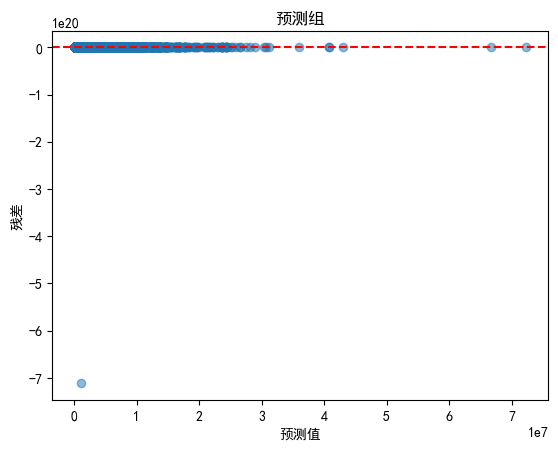

In [499]:
log_y_pred = model.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(log_y_test), residuals, alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


Text(0.5, 1.0, '预测组')

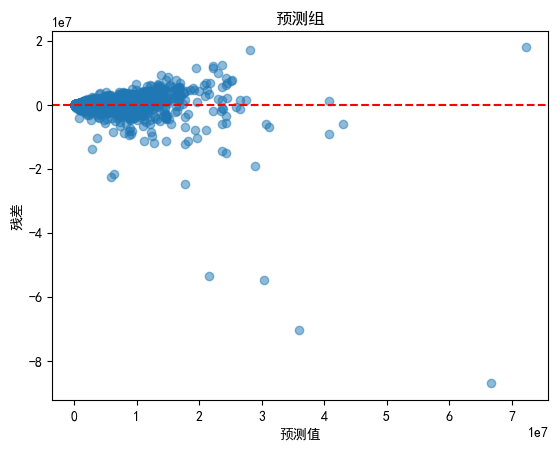

In [500]:
log_y_pred = model.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

threshold_abs = 1e20
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), filtered_residuals[mask_abs], alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")

# plt.savefig('预测组残差分布_OLS.png',bbox_inches='tight', dpi=300)

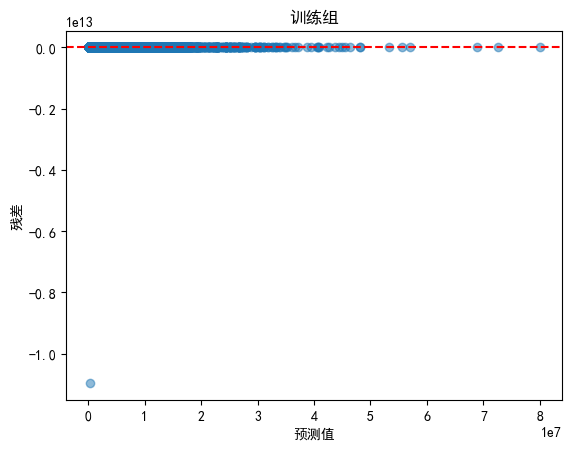

In [501]:
log_y_pred = model.predict(X_train)
y_pred2=np.expm1(log_y_pred)
residuals = y_train - y_pred2

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(log_y_train), residuals, alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("训练组")
plt.show()


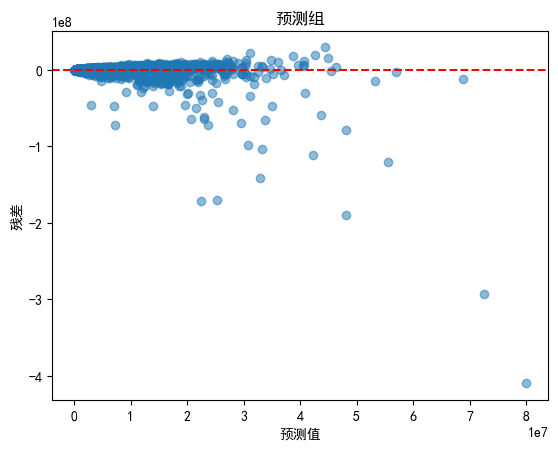

In [502]:
log_y_pred = model.predict(X_train)
y_pred2=np.expm1(log_y_pred)
residuals = y_train - y_pred2

threshold_abs = 1e13
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_train[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), filtered_residuals[mask_abs], alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


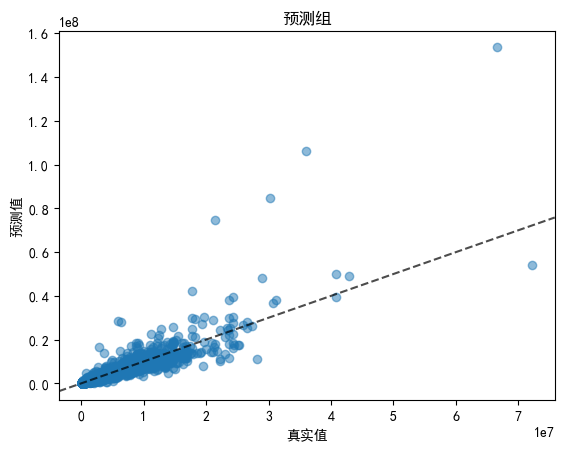

In [504]:
log_y_pred = model.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

threshold_abs = 1e20
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), np.expm1(filtered_data[mask_abs])-filtered_residuals[mask_abs], alpha=0.5)
plt.xlabel("真实值")
plt.ylabel("预测值")
plt.title("预测组")
plt.axline((0, 0), (1, 1),         # 通过(0,0)和(1,1)定义直线
           color='black', 
           linestyle='--', 
           linewidth=1.5,
           alpha=0.7,
           label='y=x参考线')

plt.show()

2、Lasso

In [510]:
X=full_dt.drop(columns=['小区名称','价格'])
Y=full_dt['价格']



# 分类变量和数值变量

categorical_features = ['城市', '区域','板块','所在楼层','建筑结构', '装修情况', '配备电梯','别墅类型', '交易权属', '房屋用途', '房屋年限', '产权所属','环线','供水','供电','供暖']
categorical_transformer = OneHotEncoder(drop='first',handle_unknown='ignore')

numeric_features = [ '房屋户型',  '建筑面积', '套内面积',
       '梯户比例',  '房屋总数', '楼栋总数', '绿 化 率', '容 积 率', '物 业 费','lon','lat','coord_x','coord_y','停车位','供热费','燃气费']
numeric_transformer = StandardScaler()


# 流程

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),  # 数值特征标准化
        ('cat', categorical_transformer, categorical_features)  # 分类特征独热编码
    ])

model1 = Pipeline(steps=[
    ('preprocessor', preprocessor),  # 数据预处理
    ('regressor', LassoCV(alphas=np.logspace(-3, 1, 5), cv=5))  # 线性回归模型
])


log_y=np.log1p(Y)

# 划分训练集和预测集

X_train, X_test, log_y_train, log_y_test = train_test_split(
    X, 
    log_y,
    test_size=0.2,  # 测试集占比20%
    random_state=120  # 随机种子（确保每次划分结果一致）
)

y_train=np.expm1(log_y_train)
y_test=np.expm1(log_y_test)


# 拟合模型

model1.fit(X_train,log_y_train)



c:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 234.87205441448305, tolerance: 4.256049198565828
  model = cd_fast.sparse_enet_coordinate_descent(
c:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 275.5383873239807, tolerance: 4.2776471919643315
  model = cd_fast.sparse_enet_coordinate_descent(
c:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 227.7793218342499, tolerance: 4.254599457620316
  model = cd_fast.sparse_enet_coordinate_descent(
c:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['房屋户型', '建筑面积', '套内面积',
                                                   '梯户比例', '房屋总数', '楼栋总数',
                                                   '绿 化 率', '容 积 率', '物 业 费',
                                                   'lon', 'lat', 'coord_x',
                                                   'coord_y', '停车位', '供热费',
                                                   '燃气费']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['城市', '区域', '板块', '所在楼层',
                                                   '建筑结构', '装修情况', '配备电梯',
                                                   '别墅类型', '交易权属', '房屋用途',
                                                   '房屋年限', '产权所属', '环线', '供水',
                                                   '供电', '供暖'])])),
                ('regressor',
                 LassoCV(alphas=array([1.e-04, 1.e-03, 1.e-02, 1.e-01, 1.e+00]),
                         cv=5))])

In [493]:
log_y_pred = model.predict(X_test)
y_pred1=np.expm1(log_y_pred)

mse = mean_squared_error(log_y_test,log_y_pred)
r2 = r2_score(log_y_test,log_y_pred)
print("预测集均方误差 (MSE):", mse)
print("预测集R² 决定系数:", r2)

# 平均绝对误差 (MAE)
mae = mean_absolute_error(log_y_test,log_y_pred)
print("MAE:", mae)

# 平均绝对百分比误差 (MAPE)
mape = mean_absolute_percentage_error(log_y_test,log_y_pred)
print("MAPE (%):", mape * 100)


预测集均方误差 (MSE): 0.3123605573593164
预测集R² 决定系数: 0.6062069120848059
MAE: 0.18644712302092656
MAPE (%): 1.327495136515059


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [483]:
log_y_pred = model1.predict(X_train)
y_pred2=np.expm1(log_y_pred)

mse = mean_squared_error(log_y_train,log_y_pred)
r2 = r2_score(log_y_train,log_y_pred)
print("训练集均方误差 (MSE):", mse)
print("训练集R² 决定系数:", r2)

# 平均绝对误差 (MAE)
mae = mean_absolute_error(log_y_train,log_y_pred)
print("MAE:", mae)

# 平均绝对百分比误差 (MAPE)
mape = mean_absolute_percentage_error(log_y_train,log_y_pred)
print("MAPE (%):", mape * 100)


训练集均方误差 (MSE): 0.06502433983014516
训练集R² 决定系数: 0.9177982638028498
MAE: 0.18228132249765006
MAPE (%): 1.3064546929754843


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


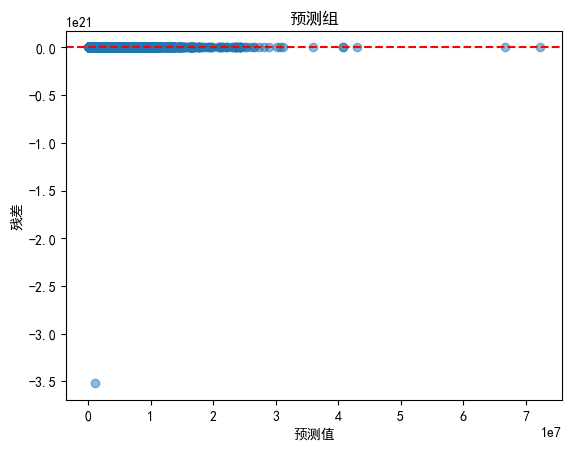

In [484]:
log_y_pred = model1.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(log_y_test), residuals, alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


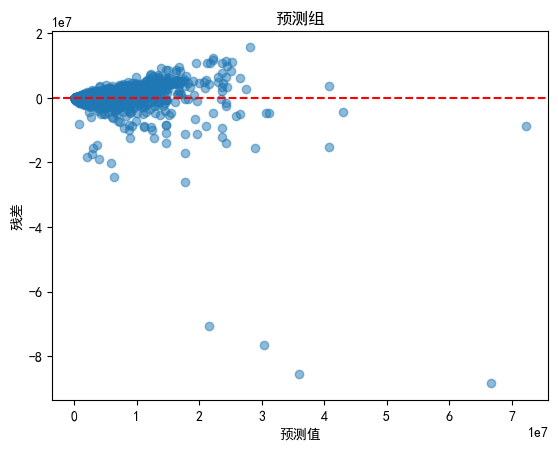

In [485]:
log_y_pred = model1.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

threshold_abs = 1e21
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), filtered_residuals[mask_abs], alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


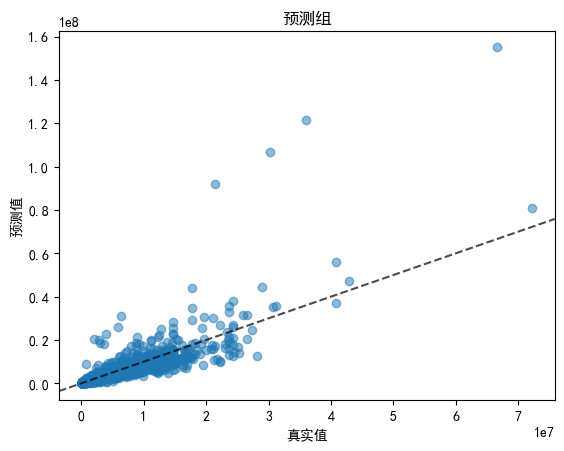

In [492]:
log_y_pred = model1.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

threshold_abs = 1e21
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), np.expm1(filtered_data[mask_abs])-filtered_residuals[mask_abs], alpha=0.5)
plt.xlabel("真实值")
plt.ylabel("预测值")
plt.title("预测组")
plt.axline((0, 0), (1, 1),         # 通过(0,0)和(1,1)定义直线
           color='black', 
           linestyle='--', 
           linewidth=1.5,
           alpha=0.7,
           label='y=x参考线')

plt.show()

3、Ridge

In [517]:
X=full_dt.drop(columns=['小区名称','价格'])
Y=full_dt['价格']



# 分类变量和数值变量

categorical_features = ['城市', '区域','板块','所在楼层','建筑结构', '装修情况', '配备电梯','别墅类型', '交易权属', '房屋用途', '房屋年限', '产权所属','环线','供水','供电','供暖']
categorical_transformer = OneHotEncoder(drop='first',handle_unknown='ignore')

numeric_features = [ '房屋户型',  '建筑面积', '套内面积',
       '梯户比例',  '房屋总数', '楼栋总数', '绿 化 率', '容 积 率', '物 业 费','lon','lat','coord_x','coord_y','停车位','供热费','燃气费']
numeric_transformer = StandardScaler()


# 流程

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),  # 数值特征标准化
        ('cat', categorical_transformer, categorical_features)  # 分类特征独热编码
    ])

model2 = Pipeline(steps=[
    ('preprocessor', preprocessor),  # 数据预处理
    ('regressor',RidgeCV(alphas=np.logspace(-3,1,10), cv=5))  # 线性回归模型
])


log_y=np.log1p(Y)

# 划分训练集和预测集

X_train, X_test, log_y_train, log_y_test = train_test_split(
    X, 
    log_y,
    test_size=0.2,  # 测试集占比20%
    random_state=120  # 随机种子（确保每次划分结果一致）
)

y_train=np.expm1(log_y_train)
y_test=np.expm1(log_y_test)


# 拟合模型

model2.fit(X_train,log_y_train)



Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['房屋户型', '建筑面积', '套内面积',
                                                   '梯户比例', '房屋总数', '楼栋总数',
                                                   '绿 化 率', '容 积 率', '物 业 费',
                                                   'lon', 'lat', 'coord_x',
                                                   'coord_y', '停车位', '供热费',
                                                   '燃气费']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['城市', '区域', '板块', '所在楼层',
                                                   '建筑结构', '装修情况', '配备电梯',
                                                   '别墅类型', '交易权属', '房屋用途',
                                                   '房屋年限', '产权所属', '环线', '供水',
                                                   '供电', '供暖'])])),
                ('regressor',
                 RidgeCV(alphas=array([1.00000000e-03, 2.78255940e-03, 7.74263683e-03, 2.15443469e-02,
       5.99484250e-02, 1.66810054e-01, 4.64158883e-01, 1.29154967e+00,
       3.59381366e+00, 1.00000000e+01]),
                         cv=5))])

In [518]:
log_y_pred = model2.predict(X_test)
y_pred1=np.expm1(log_y_pred)

mse = mean_squared_error(log_y_test,log_y_pred)
r2 = r2_score(log_y_test,log_y_pred)
print("预测集均方误差 (MSE):", mse)
print("预测集R² 决定系数:", r2)

# 平均绝对误差 (MAE)
mae = mean_absolute_error(log_y_test,log_y_pred)
print("MAE:", mae)

# 平均绝对百分比误差 (MAPE)
mape = mean_absolute_percentage_error(log_y_test,log_y_pred)
print("MAPE (%):", mape * 100)


预测集均方误差 (MSE): 0.12583215357616992
预测集R² 决定系数: 0.8413633503068119
MAE: 0.17590063827324565
MAPE (%): 1.2650376318184284


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [519]:
log_y_pred = model2.predict(X_train)
y_pred2=np.expm1(log_y_pred)

mse = mean_squared_error(log_y_train,log_y_pred)
r2 = r2_score(log_y_train,log_y_pred)
print("训练集均方误差 (MSE):", mse)
print("训练集R² 决定系数:", r2)

# 平均绝对误差 (MAE)
mae = mean_absolute_error(log_y_train,log_y_pred)
print("MAE:", mae)

# 平均绝对百分比误差 (MAPE)
mape = mean_absolute_percentage_error(log_y_train,log_y_pred)
print("MAPE (%):", mape * 100)


训练集均方误差 (MSE): 0.05877320070824417
训练集R² 决定系数: 0.9257007583206329
MAE: 0.17065819215603317
MAPE (%): 1.227674576137006


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


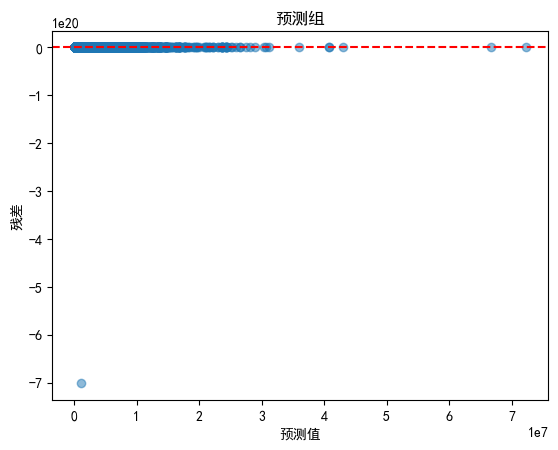

In [520]:
log_y_pred = model2.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(log_y_test), residuals, alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


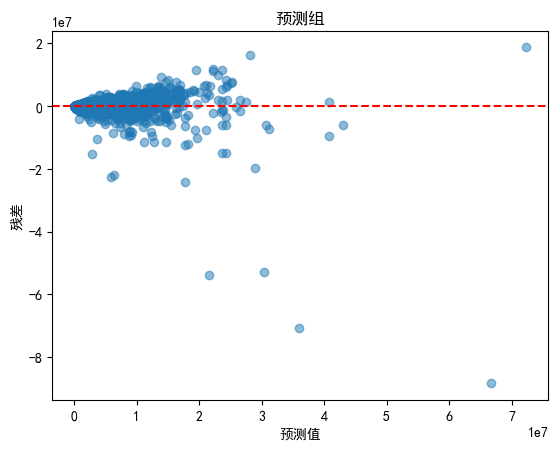

In [521]:
log_y_pred = model2.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

threshold_abs = 1e20
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), filtered_residuals[mask_abs], alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


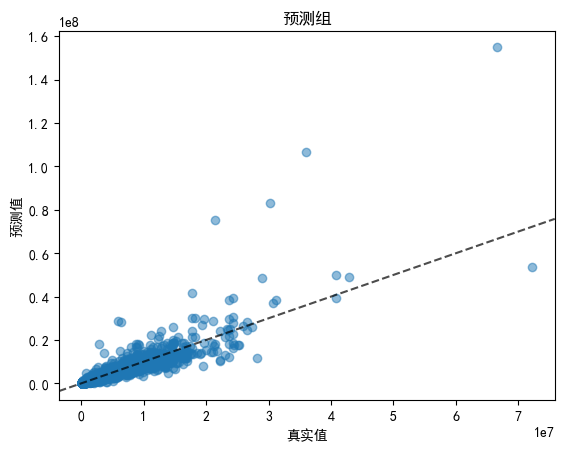

In [523]:
log_y_pred = model2.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

threshold_abs = 1e20
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), np.expm1(filtered_data[mask_abs])-filtered_residuals[mask_abs], alpha=0.5)
plt.xlabel("真实值")
plt.ylabel("预测值")
plt.title("预测组")
plt.axline((0, 0), (1, 1),         # 通过(0,0)和(1,1)定义直线
           color='black', 
           linestyle='--', 
           linewidth=1.5,
           alpha=0.7,
           label='y=x参考线')

plt.show()

4、损失函数为MAE的OLS

In [ ]:
X=full_dt.drop(columns=['小区名称','价格'])
Y=full_dt['价格']



# 分类变量和数值变量

categorical_features = ['城市', '区域','板块','所在楼层','建筑结构', '装修情况', '配备电梯','别墅类型', '交易权属', '房屋用途', '房屋年限', '产权所属','环线','供水','供电','供暖']
categorical_transformer = OneHotEncoder(drop='first',handle_unknown='ignore')

numeric_features = [ '房屋户型',  '建筑面积', '套内面积',
       '梯户比例',  '房屋总数', '楼栋总数', '绿 化 率', '容 积 率', '物 业 费','lon','lat','coord_x','coord_y','停车位','供热费','燃气费']
numeric_transformer = StandardScaler()


# 流程

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),  # 数值特征标准化
        ('cat', categorical_transformer, categorical_features)  # 分类特征独热编码
    ])

model3 = Pipeline(steps=[
    ('preprocessor', preprocessor),  # 数据预处理
    ('regressor', QuantileRegressor(
        quantile=0.5,       # 中位数回归等价于MAE最小化
        solver='highs',    # 使用线性规划求解器
        alpha=0            # 关闭L2正则化
    ))
])


log_y=np.log1p(Y)

# 划分训练集和预测集

X_train, X_test, log_y_train, log_y_test = train_test_split(
    X, 
    log_y,
    test_size=0.2,  # 测试集占比20%
    random_state=120  # 随机种子（确保每次划分结果一致）
)

y_train=np.expm1(log_y_train)
y_test=np.expm1(log_y_test)


# 拟合模型

model3.fit(X_train,log_y_train)



Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['房屋户型', '建筑面积', '套内面积',
                                                   '梯户比例', '房屋总数', '楼栋总数',
                                                   '绿 化 率', '容 积 率', '物 业 费',
                                                   'lon', 'lat', 'coord_x',
                                                   'coord_y', '停车位', '供热费',
                                                   '燃气费']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['城市', '区域', '板块', '所在楼层',
                                                   '建筑结构', '装修情况', '配备电梯',
                                                   '别墅类型', '交易权属', '房屋用途',
                                                   '房屋年限', '产权所属', '环线', '供水',
                                                   '供电', '供暖'])])),
                ('regressor', QuantileRegressor(alpha=0))])

In [526]:
log_y_pred = model3.predict(X_test)
y_pred1=np.expm1(log_y_pred)

mse = mean_squared_error(log_y_test,log_y_pred)
r2 = r2_score(log_y_test,log_y_pred)
print("预测集均方误差 (MSE):", mse)
print("预测集R² 决定系数:", r2)

# 平均绝对误差 (MAE)
mae = mean_absolute_error(log_y_test,log_y_pred)
print("MAE:", mae)

# 平均绝对百分比误差 (MAPE)
mape = mean_absolute_percentage_error(log_y_test,log_y_pred)
print("MAPE (%):", mape * 100)


预测集均方误差 (MSE): 0.38042360300671635
预测集R² 决定系数: 0.5203998014015883
MAE: 0.16603617445193017
MAPE (%): 1.1898590544385215


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [527]:
log_y_pred = model3.predict(X_train)
y_pred2=np.expm1(log_y_pred)

mse = mean_squared_error(log_y_train,log_y_pred)
r2 = r2_score(log_y_train,log_y_pred)
print("训练集均方误差 (MSE):", mse)
print("训练集R² 决定系数:", r2)

# 平均绝对误差 (MAE)
mae = mean_absolute_error(log_y_train,log_y_pred)
print("MAE:", mae)

# 平均绝对百分比误差 (MAPE)
mape = mean_absolute_percentage_error(log_y_train,log_y_pred)
print("MAPE (%):", mape * 100)


训练集均方误差 (MSE): 0.07740098940486238
训练集R² 决定系数: 0.9021520906005834
MAE: 0.1585946354575608
MAPE (%): 1.1366996754766414


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


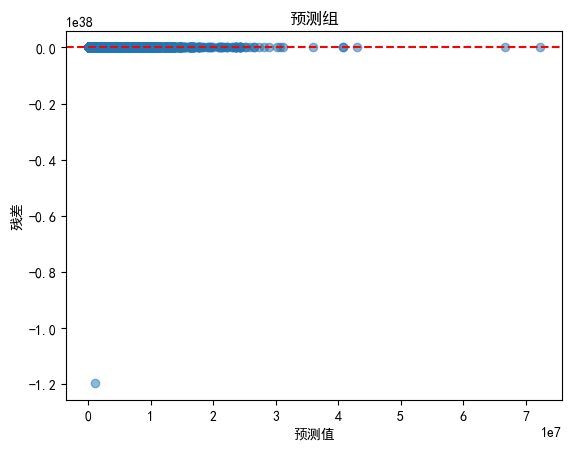

In [528]:
log_y_pred = model3.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(log_y_test), residuals, alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


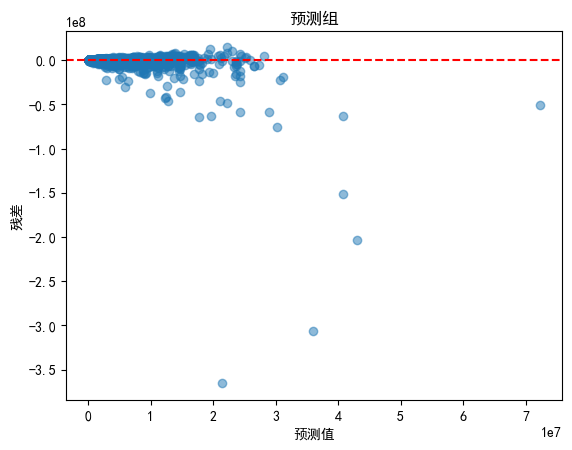

In [530]:
log_y_pred = model3.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

threshold_abs = 1e9
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), filtered_residuals[mask_abs], alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


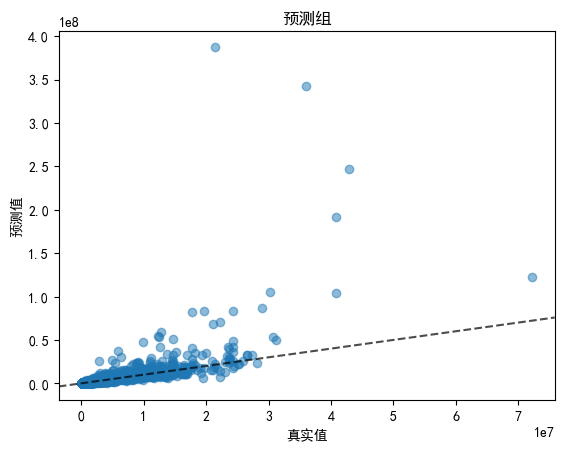

In [532]:
log_y_pred = model3.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

threshold_abs = 1e9
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), np.expm1(filtered_data[mask_abs])-filtered_residuals[mask_abs], alpha=0.5)
plt.xlabel("真实值")
plt.ylabel("预测值")
plt.title("预测组")
plt.axline((0, 0), (1, 1),         # 通过(0,0)和(1,1)定义直线
           color='black', 
           linestyle='--', 
           linewidth=1.5,
           alpha=0.7,
           label='y=x参考线')

plt.show()

## 五、生成预测数据

In [725]:
x_out=test_data1.drop(columns=['小区名称'])

y_pred = model.predict(x_out)
output['价格']=np.expm1(y_pred)
output.to_csv('test_OLS.csv',index=False)
output

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [1, 2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,ID,价格
0,0,1.571524e+07
1,1,1.131069e+07
2,2,3.456031e+06
3,3,2.693804e+06
4,4,5.349665e+06
...,...,...
14781,14781,6.004733e+05
14782,14782,6.926061e+05
14783,14783,8.654083e+05
14784,14784,7.627353e+05


In [509]:
y_pred = model1.predict(x_out)
output['价格']=np.expm1(y_pred)
output.to_csv('test_Lasso.csv',index=False)
output

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [1, 2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,ID,价格
0,0,1.260701e+06
1,1,1.260701e+06
2,2,1.260701e+06
3,3,1.260701e+06
4,4,1.260701e+06
...,...,...
14781,14781,1.260701e+06
14782,14782,1.260701e+06
14783,14783,1.260701e+06
14784,14784,1.260701e+06


In [524]:
y_pred = model2.predict(x_out)
output['价格']=np.expm1(y_pred)
output.to_csv('test_Ridge.csv',index=False)
output

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [1, 2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,ID,价格
0,0,1.586638e+07
1,1,1.129020e+07
2,2,3.465356e+06
3,3,2.693833e+06
4,4,5.423228e+06
...,...,...
14781,14781,5.974328e+05
14782,14782,6.861336e+05
14783,14783,8.503331e+05
14784,14784,7.462788e+05


In [ ]:
y_pred = model3.predict(x_out)
output['价格']=np.expm1(y_pred)
output.to_csv('test_quantile.csv',index=False)
output

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [1, 2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


,ID,价格
0,0,1.586638e+07
1,1,1.129020e+07
2,2,3.465356e+06
3,3,2.693833e+06
4,4,5.423228e+06
...,...,...
14781,14781,5.974328e+05
14782,14782,6.861336e+05
14783,14783,8.503331e+05
14784,14784,7.462788e+05


## 六、进一步的设计
根据第四部分模型拟合的结果来看，现有模型并不能完全捕获可能影响的因素，尤其表现在极大高估高价值的房产价格；因此考虑引入非线性和交叉项

In [745]:
pearson_scores = {col: pearsonr(X[col], Y)[0] for col in numeric_features}
pearson_scores

{'房屋户型': 0.3251981801145587,
 '建筑面积': 0.3936425416742461,
 '套内面积': 0.1904458548012356,
 '梯户比例': 0.11354152910123284,
 '房屋总数': -0.12311553465894012,
 '楼栋总数': 0.1336810236895592,
 '绿 化 率': -0.009999918460656794,
 '容 积 率': -0.12797039442466432,
 '物 业 费': 0.10535520131387285,
 'lon': 0.14696951021304727,
 'lat': 0.11475186287728413,
 'coord_x': 0.1486318117817445,
 'coord_y': 0.11509666477101446,
 '停车位': -0.03977559760740728,
 '供热费': 0.09067006879080279,
 '燃气费': 0.139329137918748}

In [768]:
corr_matrix=X[numeric_features].corr(method='pearson')
corr_matrix

,房屋户型,建筑面积,套内面积,梯户比例,房屋总数,楼栋总数,绿 化 率,容 积 率,物 业 费,lon,lat,coord_x,coord_y,停车位,供热费,燃气费
房屋户型,1.000000,0.591964,0.242272,0.207026,-0.062256,0.117268,-0.003010,-0.094615,0.067317,-0.254665,-0.273809,-0.213993,-0.234374,0.132527,-0.103209,-0.028950
建筑面积,0.591964,1.000000,0.230094,0.187481,-0.082974,0.090232,-0.001188,-0.063208,0.056025,-0.059550,-0.050496,-0.041653,-0.034106,0.054247,-0.031254,0.058607
套内面积,0.242272,0.230094,1.000000,0.070021,-0.043824,0.049236,-0.004536,-0.047873,0.011947,-0.006172,-0.004703,-0.002970,-0.002046,0.006287,-0.004381,0.026926
梯户比例,0.207026,0.187481,0.070021,1.000000,-0.032857,0.045023,0.001036,-0.048442,0.006279,0.067401,0.050089,0.067433,0.051265,0.044433,0.021840,0.020591
房屋总数,-0.062256,-0.082974,-0.043824,-0.032857,1.000000,0.228694,0.007139,-0.003276,0.042901,0.009979,0.027025,0.000106,0.022773,0.277731,0.045635,-0.023812
楼栋总数,0.117268,0.090232,0.049236,0.045023,0.228694,1.000000,-0.001761,-0.240428,-0.006560,0.142485,-0.016692,0.156568,-0.020060,0.045553,0.009128,0.092678
绿 化 率,-0.003010,-0.001188,-0.004536,0.001036,0.007139,-0.001761,1.000000,-0.001473,-0.001988,0.005556,0.012020,0.005599,0.012865,0.023328,-0.003837,-0.000671
容 积 率,-0.094615,-0.063208,-0.047873,-0.048442,-0.003276,-0.240428,-0.001473,1.000000,0.005149,-0.188863,-0.132908,-0.190701,-0.133842,0.011414,-0.157260,-0.095356
物 业 费,0.067317,0.056025,0.011947,0.006279,0.042901,-0.006560,-0.001988,0.005149,1.000000,-0.127973,-0.110888,-0.128411,-0.110565,0.075930,-0.011555,-0.034213
lon,-0.254665,-0.059550,-0.006172,0.067401,0.009979,0.142485,0.005556,-0.188863,-0.127973,1.000000,0.821765,0.903413,0.733354,-0.202716,0.438897,0.269416


In [774]:
f_scores, _ = f_classif(X[categorical_features], Y)
f_scores=pd.DataFrame(f_scores,columns=['分数'])
f_scores['变量名']=categorical_features
f_scores

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [3] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\ProgramData\anaconda3\Lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,分数,变量名
0,389.043041,城市
1,4.385991,区域
2,1.858295,板块
3,NaN,所在楼层
4,4.055642,建筑结构
5,1.458391,装修情况
6,4.954807,配备电梯
7,11.009247,别墅类型
8,2.644119,交易权属
9,14.444791,房屋用途


In [819]:


X_pro=full_dt.drop(columns=['小区名称','价格','房屋年限','所在楼层','装修情况','绿 化 率','容 积 率','coord_x','coord_y','停车位','供热费','燃气费'])
Y=full_dt['价格']

X_pro.to_csv('X_pro.csv',index=False)

# 分类变量和数值变量

categorical_features_pro = ['城市', '区域','板块','建筑结构','产权所属' , '配备电梯','别墅类型', '交易权属', '房屋用途','环线','供水','供电','供暖']
categorical_transformer = OneHotEncoder(drop='first',handle_unknown='ignore')

numeric_features_pro = [ '房屋户型',  '建筑面积', '套内面积','梯户比例', '房屋总数', '楼栋总数','物 业 费','lon','lat']
numeric_transformer = StandardScaler()


# 流程

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features_pro),  # 数值特征标准化
        ('cat', categorical_transformer, categorical_features_pro)  # 分类特征独热编码
    ])

model_pro = Pipeline(steps=[
    ('preprocessor', preprocessor),  # 数据预处理
    ('regressor',  LinearRegression())
])


log_y=np.log1p(Y)

# 划分训练集和预测集

X_train, X_test, log_y_train, log_y_test = train_test_split(
    X_pro, 
    log_y,
    test_size=0.2,  # 测试集占比20%
    random_state=120  # 随机种子（确保每次划分结果一致）
)

y_train=np.expm1(log_y_train)
y_test=np.expm1(log_y_test)


# 拟合模型

model_pro.fit(X_train,log_y_train)




Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['房屋户型', '建筑面积', '套内面积',
                                                   '梯户比例', '房屋总数', '楼栋总数',
                                                   '物 业 费', 'lon', 'lat']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['城市', '区域', '板块', '建筑结构',
                                                   '产权所属', '配备电梯', '别墅类型',
                                                   '交易权属', '房屋用途', '环线', '供水',
                                                   '供电', '供暖'])])),
                ('regressor', LinearRegression())])

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


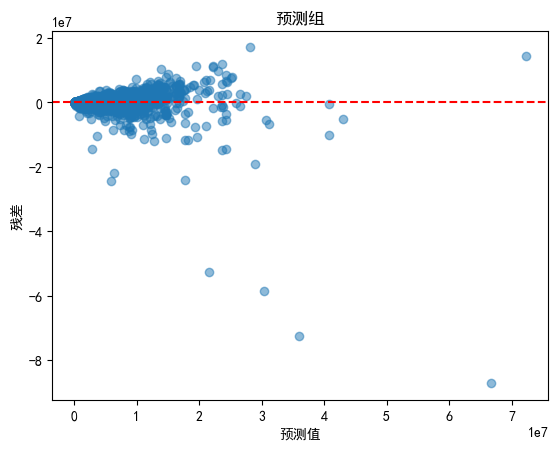

In [820]:
log_y_pred = model_pro.predict(X_test)
y_pred1=np.expm1(log_y_pred)
residuals = y_test - y_pred1

threshold_abs = 1e20
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), filtered_residuals[mask_abs], alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

In [821]:
x_out=test_data1.drop(columns=['小区名称','房屋年限','所在楼层','装修情况','绿 化 率','容 积 率','coord_x','coord_y','停车位','供热费','燃气费'])

y_pred = model_pro.predict(x_out)
output['价格']=np.expm1(y_pred)
output.to_csv('test_OLS_pro.csv',index=False)

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [1, 2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


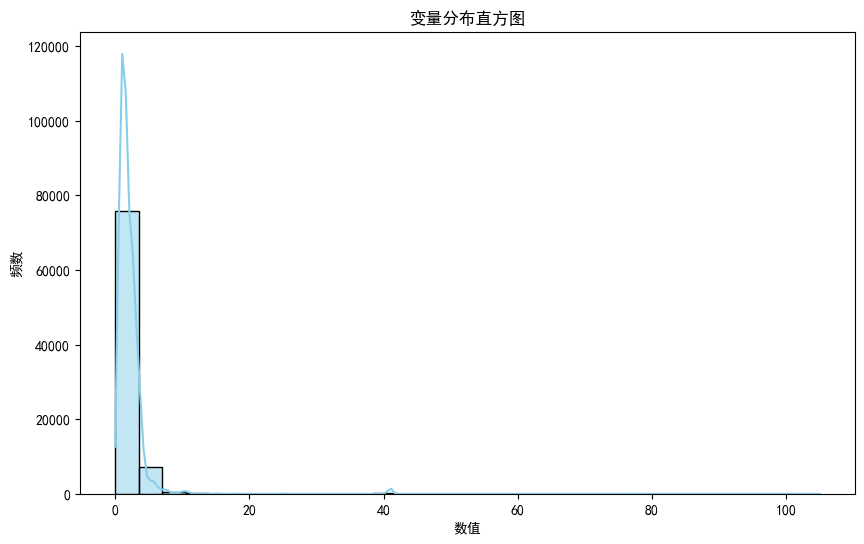

In [801]:
plt.figure(figsize=(10,6))
sns.histplot(X_pro['物 业 费'], kde=True, bins=30, color='skyblue')
plt.title('变量分布直方图')
plt.xlabel('数值')
plt.ylabel('频数')
plt.show()

# '房屋户型',  '建筑面积', '套内面积','梯户比例', '房屋总数', '楼栋总数','物 业 费','lon','lat'

In [ ]:
def outlier(df):
    condition1 = df["套内面积"] > df["建筑面积"] 
    condition2 = (df["套内面积"] / df["建筑面积"]) <0.1
    c3=df['建筑面积']>2000
    c4=df['房屋总数']>10000
    df_cleaned = df[~(condition1 | condition2|c3|c4)]
    
    return df_cleaned

Text(0.5, 1.0, '梯户比例 vs 房价 ')

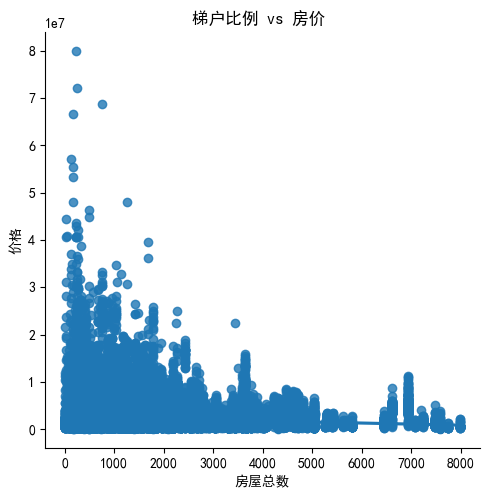

In [826]:
dt_no_outlier=outlier(full_dt)
sns.lmplot(x='房屋总数', y='价格', data=dt_no_outlier)
plt.title("梯户比例 vs 房价 ")

# '房屋户型',  '建筑面积', '套内面积','梯户比例', '房屋总数', '楼栋总数','物 业 费','lon','lat'

In [25]:

X_pro=full_dt.drop(columns=['小区名称','价格','房屋年限','所在楼层','装修情况','绿 化 率','容 积 率','coord_x','coord_y','停车位','供热费','燃气费'])
Y=full_dt['价格']

# 需要生成非线性的特征列表
nonlinear_features = ['房屋户型', '建筑面积', '套内面积','梯户比例', '房屋总数', '楼栋总数']

# 其他保持标准化的数值特征
other_numeric = ['物 业 费','lon','lat'] 

# 分类特征保持不变
categorical_features_pro = [ '区域','板块','建筑结构','产权所属' , '配备电梯','别墅类型', '交易权属', '房屋用途','环线','供水','供电','供暖','城市']

# 定义新的预处理流程
preprocessor = ColumnTransformer(
    transformers=[
        # 对非线性特征生成二次项后标准化
        ('nonlinear', Pipeline(steps=[
            ('poly', PolynomialFeatures(degree=4, include_bias=False, interaction_only=False)),
            ('scaler', StandardScaler())
        ]), nonlinear_features),
        
        # 其他数值特征仅标准化
        ('num', StandardScaler(), other_numeric),
        
        # 分类特征独热编码
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_features_pro)
    ])

# 更新模型Pipeline
model_pro = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

# 保持原有数据划分和log变换
log_y = np.log1p(Y)
X_train, X_test, log_y_train, log_y_test = train_test_split(
    X_pro, 
    log_y,
    test_size=0.2,
    random_state=120
)

# 拟合模型
model_pro.fit(X_train, log_y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('nonlinear',
                                                  Pipeline(steps=[('poly',
                                                                   PolynomialFeatures(degree=4,
                                                                                      include_bias=False)),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['房屋户型', '建筑面积', '套内面积',
                                                   '梯户比例', '房屋总数', '楼栋总数']),
                                                 ('num', StandardScaler(),
                                                  ['物 业 费', 'lon', 'lat']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['区域', '板块', '建筑结构', '产权所属',
                                                   '配备电梯', '别墅类型', '交易权属',
                                                   '房屋用途', '环线', '供水', '供电',
                                                   '供暖', '城市'])])),
                ('regressor', LinearRegression())])

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [1] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


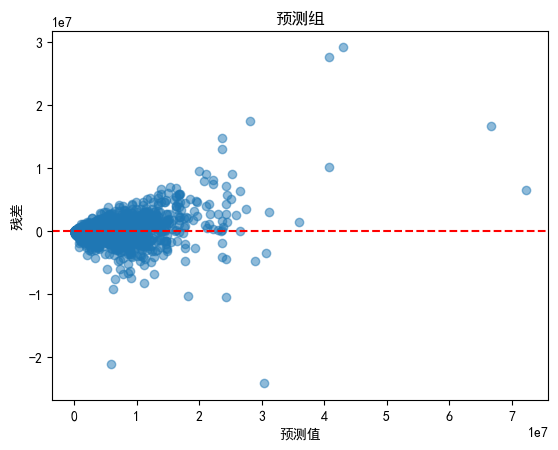

In [26]:
log_y_pred = model_pro.predict(X_test)
y_pred1=np.expm1(log_y_pred)
y_test=np.expm1(log_y_test)
residuals = y_test - y_pred1

threshold_abs = 1e8
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), filtered_residuals[mask_abs], alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

In [27]:
x_out=test_data1.drop(columns=['小区名称','房屋年限','所在楼层','装修情况','绿 化 率','容 积 率','coord_x','coord_y','停车位','供热费','燃气费'])

y_pred = model_pro.predict(x_out)
output['价格']=np.expm1(y_pred)
output.to_csv('test_OLS_pro_4.csv',index=False)

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [0, 1] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [32]:

X_pro=full_dt.drop(columns=['小区名称','价格','房屋年限','所在楼层','装修情况','绿 化 率','容 积 率','coord_x','coord_y','停车位','供热费','燃气费'])
Y=full_dt['价格']

# 需要生成非线性的特征列表
nonlinear_features = ['房屋户型', '建筑面积', '套内面积','梯户比例', '房屋总数', '楼栋总数']

# 其他保持标准化的数值特征
other_numeric = ['物 业 费','lon','lat'] 

# 分类特征保持不变
categorical_features_pro = [ '区域','板块','建筑结构','产权所属' , '配备电梯','别墅类型', '交易权属', '房屋用途','环线','供水','供电','供暖','城市']

# 定义新的预处理流程
preprocessor = ColumnTransformer(
    transformers=[
        # 对非线性特征生成二次项后标准化
        ('nonlinear', Pipeline(steps=[
            ('poly', PolynomialFeatures(degree=2, include_bias=False, interaction_only=False)),
            ('scaler', StandardScaler())
        ]), nonlinear_features),
        
        # 其他数值特征仅标准化
        ('num', StandardScaler(), other_numeric),
        
        # 分类特征独热编码
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_features_pro)
    ])

# 更新模型Pipeline
model_pro = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

# 保持原有数据划分和log变换
log_y = np.log1p(Y)
X_train, X_test, log_y_train, log_y_test = train_test_split(
    X_pro, 
    log_y,
    test_size=0.2,
    random_state=120
)

# 拟合模型
model_pro.fit(X_train, log_y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('nonlinear',
                                                  Pipeline(steps=[('poly',
                                                                   PolynomialFeatures(include_bias=False)),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['房屋户型', '建筑面积', '套内面积',
                                                   '梯户比例', '房屋总数', '楼栋总数']),
                                                 ('num', StandardScaler(),
                                                  ['物 业 费', 'lon', 'lat']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['区域', '板块', '建筑结构', '产权所属',
                                                   '配备电梯', '别墅类型', '交易权属',
                                                   '房屋用途', '环线', '供水', '供电',
                                                   '供暖', '城市'])])),
                ('regressor', LinearRegression())])

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [1] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


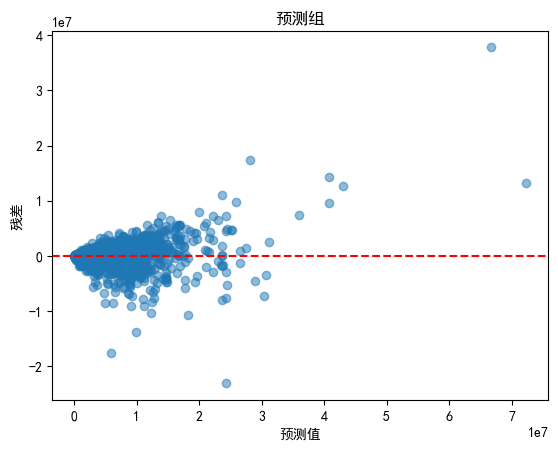

In [33]:
log_y_pred = model_pro.predict(X_test)
y_pred1=np.expm1(log_y_pred)
y_test=np.expm1(log_y_test)
residuals = y_test - y_pred1

threshold_abs = 1e8
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), filtered_residuals[mask_abs], alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

In [34]:
x_out=test_data1.drop(columns=['小区名称','房屋年限','所在楼层','装修情况','绿 化 率','容 积 率','coord_x','coord_y','停车位','供热费','燃气费'])

y_pred = model_pro.predict(x_out)
output['价格']=np.expm1(y_pred)
output.to_csv('test_OLS_pro_4.csv',index=False)

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [0, 1] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [1] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


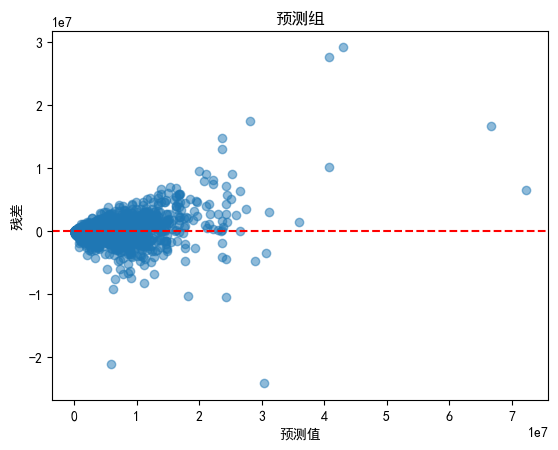

In [ ]:
log_y_pred = model_pro.predict(X_test)
y_pred1=np.expm1(log_y_pred)
y_test=np.expm1(log_y_test)
residuals = y_test - y_pred1

threshold_abs = 1e8
mask_abs = np.abs(residuals) < threshold_abs

filtered_data = log_y_test[mask_abs]
filtered_residuals = residuals[mask_abs]

# 绘制残差 vs 预测值图
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False 

plt.scatter(np.expm1(filtered_data[mask_abs]), filtered_residuals[mask_abs], alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')  # 添加参考线
plt.xlabel("预测值")
plt.ylabel("残差")
plt.title("预测组")
plt.show()

In [ ]:
x_out=test_data1.drop(columns=['小区名称','房屋年限','所在楼层','装修情况','绿 化 率','容 积 率','coord_x','coord_y','停车位','供热费','燃气费'])

y_pred = model_pro.predict(x_out)
output['价格']=np.expm1(y_pred)
output.to_csv('test_OLS_pro_4.csv',index=False)

c:\ProgramData\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [0, 1] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
